# Style Transfer and Style-Guided Diffusion

This exercise theme is Style Manipulation and Classifier-guided Denoising Diffusion.

For the purpose of this exercise we will follow the loss implementations of the [Pytorch Neural Transfer](https://pytorch.org/tutorials/advanced/neural_style_tutorial.html) notebook.

The pre-trained model we will use is the VGG-19 neural network.

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

import torchvision.transforms as transforms
import torchvision.models as models

import copy

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Loading the Images

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# desired size of the output image
imsize = 512 if torch.cuda.is_available() else 128  # use small size if no GPU

loader = transforms.Compose([
    transforms.Resize(imsize),  # scale imported image
    transforms.ToTensor()])  # transform it into a torch tensor


def image_loader(image_name):
    image = Image.open(image_name)
    # fake batch dimension required to fit network's input dimensions
    image = loader(image).unsqueeze(0)
    return image.to(device, torch.float)

In [ ]:
unloader = transforms.ToPILImage()  # reconvert into PIL image

plt.ion()

def imshow(tensor, title=None):
    image = tensor.cpu().clone()  # we clone the tensor to not do changes on it
    image = image.squeeze(0)      # remove the fake batch dimension
    image = unloader(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)
    plt.pause(0.001) # pause a bit so that plots are updated

# Loss Functions

## Content Loss

The content loss is a function that represents a weighted version of the
content distance for an individual layer. The function takes the feature
maps $F_{XL}$ of a layer $L$ in a network processing input $X$ and returns the
weighted content distance $w_{CL}.D_C^L(X,C)$ between the image $X$ and the
content image $C$. The feature maps of the content image($F_{CL}$) must be
known by the function in order to calculate the content distance. We
implement this function as a torch module with a constructor that takes
$F_{CL}$ as an input. The distance $\|F_{XL} - F_{CL}\|^2$ is the mean square error
between the two sets of feature maps, and can be computed using ``nn.MSELoss``.

We will add this content loss module directly after the convolution
layer(s) that are being used to compute the content distance. This way
each time the network is fed an input image the content losses will be
computed at the desired layers and because of auto grad, all the
gradients will be computed. Now, in order to make the content loss layer
transparent we must define a ``forward`` method that computes the content
loss and then returns the layer’s input. The computed loss is saved as a
parameter of the module.

In [ ]:
class ContentLoss(nn.Module):

    def __init__(self, target,):
        super(ContentLoss, self).__init__()
        # we 'detach' the target content from the tree used
        # to dynamically compute the gradient: this is a stated value,
        # not a variable. Otherwise the forward method of the criterion
        # will throw an error.
        self.target = target.detach()

    def forward(self, input):
        self.loss = F.mse_loss(input, self.target)
        return input

## Style Loss

The style loss module is implemented similarly to the content loss
module. It will act as a transparent layer in a
network that computes the style loss of that layer. In order to
calculate the style loss, we need to compute the gram matrix $G_{XL}$. A gram
matrix is the result of multiplying a given matrix by its transposed
matrix. In this application the given matrix is a reshaped version of
the feature maps $F_{XL}$ of a layer $L$. $F_{XL}$ is reshaped to form $\hat{F}_{XL}$, a $K$\ x\ $N$
matrix, where $K$ is the number of feature maps at layer $L$ and $N$ is the
length of any vectorized feature map $F_{XL}^k$. For example, the first line
of $\hat{F}_{XL}$ corresponds to the first vectorized feature map $F_{XL}^1$.

Finally, the gram matrix must be normalized by dividing each element by
the total number of elements in the matrix. This normalization is to
counteract the fact that $\hat{F}_{XL}$ matrices with a large $N$ dimension yield
larger values in the Gram matrix. These larger values will cause the
first layers (before pooling layers) to have a larger impact during the
gradient descent. Style features tend to be in the deeper layers of the
network so this normalization step is crucial.

In [ ]:
def gram_matrix(input):
    a, b, c, d = input.size()  # a=batch size(=1)
    # b=number of feature maps
    # (c,d)=dimensions of a f. map (N=c*d)

    features = input.view(a * b, c * d)  # resize F_XL into \hat F_XL

    G = torch.mm(features, features.t())  # compute the gram product

    # we 'normalize' the values of the gram matrix
    # by dividing by the number of element in each feature maps.
    return G.div(a * b * c * d)

Now the style loss module looks almost exactly like the content loss
module. The style distance is also computed using the mean square
error between $G_{XL}$ and $G_{SL}$.

In [ ]:
class StyleLoss(nn.Module):

    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = gram_matrix(target_feature).detach()

    def forward(self, input):
        G = gram_matrix(input)
        self.loss = F.mse_loss(G, self.target)
        return input

# Importing the Model

In [ ]:
cnn = models.vgg19(pretrained=True).features.to(device).eval()

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:07<00:00, 72.3MB/s]


# Normalize images

In [ ]:
cnn_normalization_mean = torch.tensor([0.485, 0.456, 0.406]).to(device)
cnn_normalization_std = torch.tensor([0.229, 0.224, 0.225]).to(device)

# create a module to normalize input image so we can easily put it in a
# ``nn.Sequential``
class Normalization(nn.Module):
    def __init__(self, mean, std):
        super(Normalization, self).__init__()
        # .view the mean and std to make them [C x 1 x 1] so that they can
        # directly work with image Tensor of shape [B x C x H x W].
        # B is batch size. C is number of channels. H is height and W is width.
        self.mean = torch.tensor(mean).view(-1, 1, 1)
        self.std = torch.tensor(std).view(-1, 1, 1)

    def forward(self, img):
        # normalize ``img``
        return (img - self.mean) / self.std

# L-BFGS algorithm

As Leon Gatys, the author of the algorithm, suggested here, we will use L-BFGS algorithm to run our gradient descent.

In [ ]:
def get_input_optimizer(input_img):
    # this line to show that input is a parameter that requires a gradient
    optimizer = optim.LBFGS([input_img])
    return optimizer

# Part 1 - Neural Style Transfer algorithm

## A. Feature Inversion

We'll modify the style-transfer alogirthm to invert features from different stages of the
VGG-19 network. More specifically, given a target image, record its feature map Φ at the output
of one of the layers of VGG-19. Next initialize an input image to noise, and optimize the
input until its feature map for that layer closely approximates Φ.

The content image we're using is of a church.

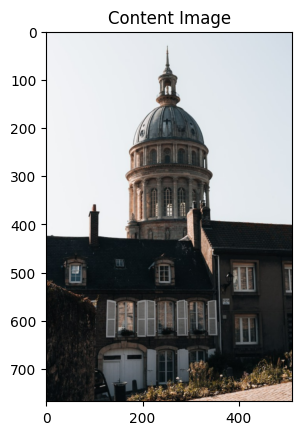

In [ ]:
content_img_path = '/content/drive/MyDrive/ex4_NN4I/church.jpg'
content_img = image_loader(content_img_path)

plt.figure()
imshow(content_img, title='Content Image')

A modified get style module -> get content model function which return a cnn (vgg based) module, that is trimmed up to `layer_name`,


In [ ]:
# desired depth layers to compute style/content losses :

def get_content_model_and_losses(cnn, normalization_mean, normalization_std,
                                 content_img,
                                 layer_name='conv_4'):

    # normalization module
    normalization = Normalization(normalization_mean, normalization_std).to(device)

    # just in order to have an iterable access to or list of content/style
    # losses
    content_loss = None

    # assuming that ``cnn`` is a ``nn.Sequential``, so we make a new ``nn.Sequential``
    # to put in modules that are supposed to be activated sequentially
    model = nn.Sequential(normalization)
    content_losses =[]
    seen_layer_name = False
    i = 0  # increment every time we see a conv
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            # The in-place version doesn't play very nicely with the ``ContentLoss``
            # and ``StyleLoss`` we insert below. So we replace with out-of-place
            # ones here.
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        if name[0 : 4] == layer_name[0 : 4]:
          if seen_layer_name == False:
              model.add_module(name, layer)

              # add style loss:
              target = model(style_img).detach()
              content_loss = ContentLoss(target)
              content_losses.append(content_loss)
              model.add_module("content_loss_{}".format(i), content_loss)
              if name == layer_name:
                seen_layer_name = True
        else:
             model.add_module(name, layer)

    # now we trim off the layers after the last content and style losses
    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], ContentLoss):
            break

    model = model[:(i + 1)]

    return model, content_losses

The run feature inversion, is a modification to the Style trasfer algorithem, in which a target image is given, in addition a name of layer is given also to pass to `get_content_model_and_losses` for getting appropriate model, and returning the original activation map after layer that was given.

In [ ]:
def run_feature_inversion(cnn, normalization_mean, normalization_std,
                          content_img,
                          input_img,
                          layer_name="conv_4",
                          num_steps=300,
                          content_weight=100000,
                          log=False):
    """Run feature inversion."""
    if log:
      print('Building the feature inversion model..')
    model,  content_losses = get_content_model_and_losses(cnn,
                                normalization_mean, normalization_std,
                                content_img, layer_name=layer_name)

    # We want to optimize the input and not the model parameters so we
    # update all the requires_grad fields accordingly
    input_img.requires_grad_(True)
    # We also put the model in evaluation mode, so that specific layers
    # such as dropout or batch normalization layers behave correctly.
    model.eval()
    model.requires_grad_(False)

    optimizer = get_input_optimizer(input_img)

    if log:
      print('Optimizing..')
    run = [0]
    while run[0] <= num_steps:

        def closure():
            # correct the values of updated input image
            with torch.no_grad():
                input_img.clamp_(0, 1)

            optimizer.zero_grad()
            model(input_img)
            loss = 0
            for cl in content_losses:
              loss += cl.loss
            loss *= content_weight
            loss.backward()

            run[0] += 1
            if run[0] % 50 == 0 and log:
                print("run {}:".format(run))
                print('Content Loss: {:4f}'.format(loss.item()))
                print()

            return loss

        optimizer.step(closure)


    # a last correction...
    with torch.no_grad():
        input_img.clamp_(0, 1)

    return input_img , closure()

Now run feature inversion on different types and depthes of layers

In [ ]:
def get_cnn_features_layers_names_filtered(cnn, filters=["conv"]):
    cnn_layer_names = []
    i = 0  # increment every time we see a conv
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            # The in-place version doesn't play very nicely with the ``ContentLoss``
            # and ``StyleLoss`` we insert below. So we replace with out-of-place
            # ones here.
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        if name[0 : 4]  in filters:
          cnn_layer_names.append(name)

    return cnn_layer_names

<ipython-input-10-a40ef7ea97e5>:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.mean = torch.tensor(mean).view(-1, 1, 1)
<ipython-input-10-a40ef7ea97e5>:13: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.std = torch.tensor(std).view(-1, 1, 1)


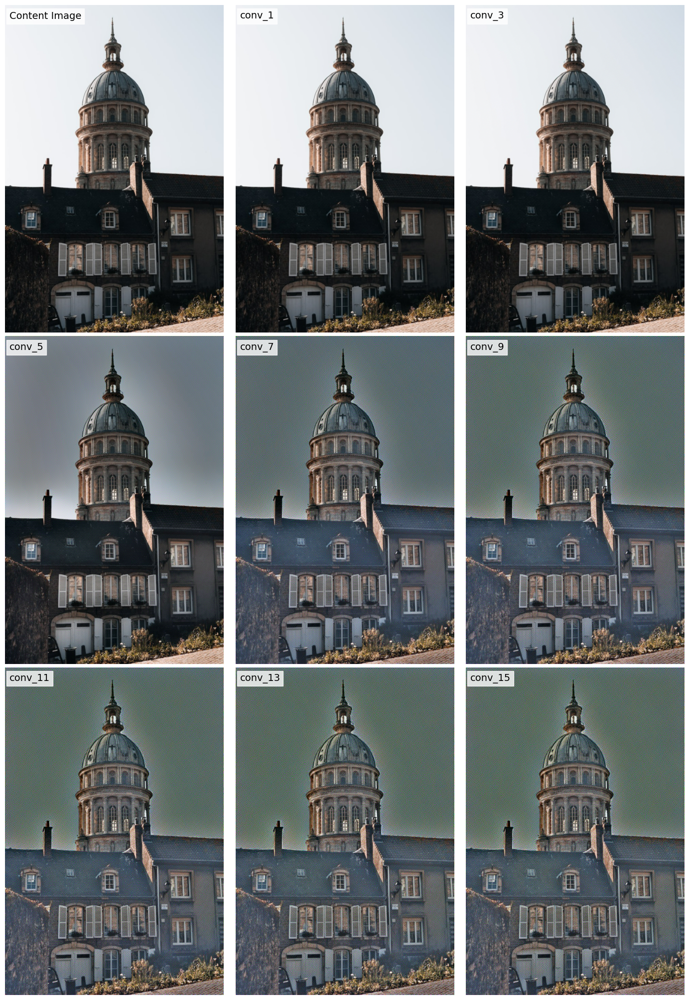

In [ ]:
losses = []
images = [content_img]
layer_names = ["Content Image"]
model_layer_names = get_cnn_features_layers_names_filtered(cnn, ["conv"])

# Loop through the layers and add the inverted features to images.
for i in range(0,  len(model_layer_names), 2):
    layer_name = model_layer_names[i]
    input_img = torch.randn(content_img.data.size()).to(device)

    input_img, loss = run_feature_inversion(cnn,
                                            cnn_normalization_mean,
                                            cnn_normalization_std,
                                            content_img,
                                            input_img,
                                            layer_name)

    layer_names.append(layer_name)
    images.append(input_img)
    losses.append(loss)

# Calculate the number of rows and columns in the subplot grid based on the length of the images list
K = len(images)
n = int(np.sqrt(K))
m = int(np.ceil(K / n))

# Create grid figure
plt.ioff()
fig, axes = plt.subplots(m, n, figsize=(15, 20), tight_layout={'pad': 0.5})

for i, ax in enumerate(axes.flat):
    if i < len(images):

      image = images[i].cpu().clone()  # we clone the tensor to not do changes on it
      image = image.squeeze(0)      # remove the fake batch dimension
      image = unloader(image)

      ax.imshow(image)
      ax.axis('off')

      # Add the layer name as text with a white background in the upper left corner
      text = ax.text(0.02, 0.98, f'{layer_names[i]}', transform=ax.transAxes,
                     fontsize=14, ha='left', va='top')
      text.set_bbox(dict(facecolor='white', edgecolor='white', alpha=0.8))

    else:
      ax.axis('off')

# Specify the customized file path
save_path = '/content/drive/MyDrive/ex4_NN4I/feature_inversion_church.jpeg'

# Save the figure at the specified path
plt.savefig(save_path, format='jpeg')

# Show the final plot
plt.show()

## B. Texture Synthesis

We'll modify the style-transfer alogirthm to generate a texture inspired by the style input.

The style image we're using is the famous Starry Night painting by Van Gogh.

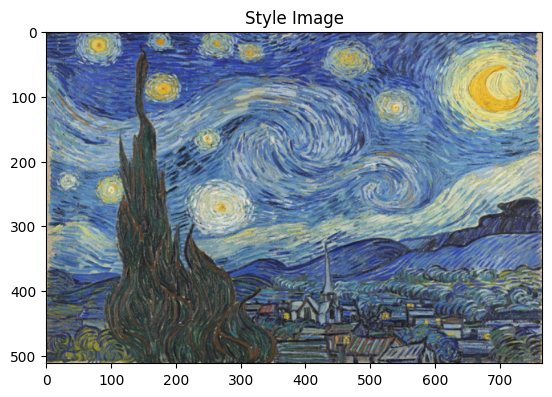

In [ ]:
style_img_path = '/content/drive/MyDrive/ex4_NN4I/starry_night.jpg'
style_img = image_loader(style_img_path)

plt.figure()
imshow(style_img, title='Style Image')

In [ ]:
# desired depth layers to compute style/content losses :

def get_style_model_and_losses(cnn,
                               normalization_mean,
                               normalization_std,
                               style_img,
                               layer_name='conv_4'):

    # normalization module
    normalization = Normalization(normalization_mean, normalization_std).to(device)

    # just in order to have an iterable access to or list of content/style
    # losses
    style_losses = []

    # assuming that ``cnn`` is a ``nn.Sequential``, so we make a new ``nn.Sequential``
    # to put in modules that are supposed to be activated sequentially
    model = nn.Sequential(normalization)

    seen_layer_name = False
    i = 0  # increment every time we see a conv
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            # The in-place version doesn't play very nicely with the ``ContentLoss``
            # and ``StyleLoss`` we insert below. So we replace with out-of-place
            # ones here.
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        if name[0 : 4] == layer_name[0 : 4]:
          if seen_layer_name == False:
              model.add_module(name, layer)

              # add style loss:
              target = model(style_img).detach()
              style_loss = StyleLoss(target)
              style_losses.append(style_loss)
              model.add_module("style_loss_{}".format(i), style_loss)
              if name == layer_name:
                seen_layer_name = True
        else:
             model.add_module(name, layer)



    # now we trim off the layers after the last style losses
    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], StyleLoss):
            break

    model = model[:(i + 1)]

    return model, style_losses

In [ ]:
def run_texture_synthesis(cnn, normalization_mean, normalization_std,
                          style_img,
                          input_img,
                          layer_name="conv_4",
                          num_steps=300,
                          style_weight=1000000,
                          log=False):
    """Run texture synthesis."""
    if log:
      print('Building the texture synthesis model..')
    model,  style_losses = get_style_model_and_losses(cnn,
                                normalization_mean, normalization_std,
                                style_img, layer_name=layer_name)

    # We want to optimize the input and not the model parameters so we
    # update all the requires_grad fields accordingly
    input_img.requires_grad_(True)
    # We also put the model in evaluation mode, so that specific layers
    # such as dropout or batch normalization layers behave correctly.
    model.eval()
    model.requires_grad_(False)

    optimizer = get_input_optimizer(input_img)

    if log:
      print('Optimizing..')
    run = [0]
    while run[0] <= num_steps:

        def closure():
            optimizer.zero_grad()

            # correct the values of updated input image
            with torch.no_grad():
                input_img.clamp_(0, 1)

            model(input_img)

            loss = 0
            for sl in style_losses:
                loss += sl.loss
            loss *= style_weight
            loss.backward()

            run[0] += 1
            if run[0] % 50 == 0 and log:
                print("run {}:".format(run))
                print('Style Loss: {:4f}'.format(loss.item()))
                print()

            return loss

        optimizer.step(closure)


    # a last correction...
    with torch.no_grad():
        input_img.clamp_(0, 1)

    return input_img, closure()

In [ ]:
def get_cnn_features_layers_names_filtered(cnn, filters=["conv"]):
    cnn_layer_names = []
    i = 0  # increment every time we see a conv
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            # The in-place version doesn't play very nicely with the ``ContentLoss``
            # and ``StyleLoss`` we insert below. So we replace with out-of-place
            # ones here.
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        if name[0 : 4]  in filters:
          cnn_layer_names.append(name)

    return cnn_layer_names

Building the texture synthesis model..
Optimizing..


<ipython-input-62-a40ef7ea97e5>:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.mean = torch.tensor(mean).view(-1, 1, 1)
<ipython-input-62-a40ef7ea97e5>:13: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.std = torch.tensor(std).view(-1, 1, 1)


run [50]:
Style Loss: 0.002731

run [100]:
Style Loss: 0.000172

run [150]:
Style Loss: 0.000040

run [200]:
Style Loss: 0.000023

run [250]:
Style Loss: 0.000023

run [300]:
Style Loss: 0.000023

Building the texture synthesis model..
Optimizing..
run [50]:
Style Loss: 12.155687

run [100]:
Style Loss: 3.809042

run [150]:
Style Loss: 1.961594

run [200]:
Style Loss: 1.194842

run [250]:
Style Loss: 0.718230

run [300]:
Style Loss: 0.383433

Building the texture synthesis model..
Optimizing..
run [50]:
Style Loss: 76.843567

run [100]:
Style Loss: 22.838758

run [150]:
Style Loss: 12.489465

run [200]:
Style Loss: 7.134168

run [250]:
Style Loss: 4.728248

run [300]:
Style Loss: 3.502561

Building the texture synthesis model..
Optimizing..
run [50]:
Style Loss: 307.752960

run [100]:
Style Loss: 55.181576

run [150]:
Style Loss: 25.566410

run [200]:
Style Loss: 15.952935

run [250]:
Style Loss: 10.614537

run [300]:
Style Loss: 7.578969

Building the texture synthesis model..
Optimiz

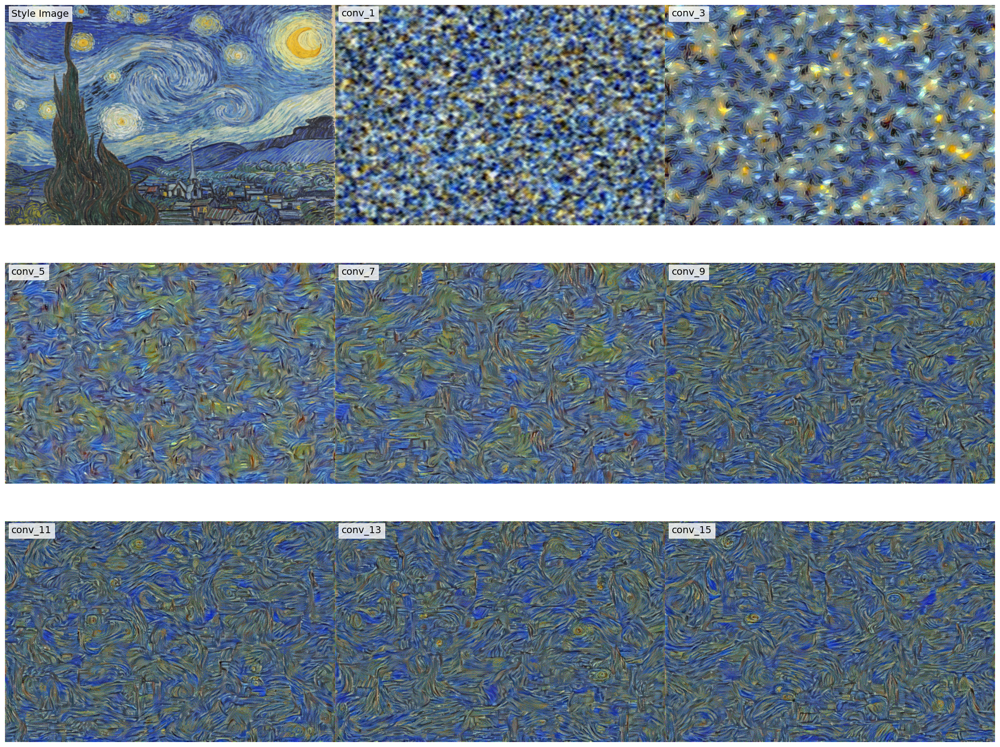

In [ ]:
losses = []
images = [style_img]
layer_names = ["Style Image"]
model_layer_names = get_cnn_features_layers_names_filtered(cnn, filters=["conv"])

# Loop through the layers and add the syntisized textures to images.
for i in range(0,  len(model_layer_names), 2):
    layer_name = model_layer_names[i]
    input_img = torch.randn(style_img.data.size()).to(device)

    input_img, loss = run_texture_synthesis(cnn,
                                            cnn_normalization_mean,
                                            cnn_normalization_std,
                                            style_img,
                                            input_img,
                                            layer_name,
                                            log=True)

    layer_names.append(layer_name)
    images.append(input_img)
    losses.append(loss)

# Calculate the number of rows and columns in the subplot grid based on the length of the images list
K = len(images)
n = int(np.sqrt(K))
m = int(np.ceil(K / n))

# Create grid figure
plt.ioff()
fig, axes = plt.subplots(m, n, figsize=(20, 20), tight_layout={'pad': 0.})

for i, ax in enumerate(axes.flat):
    if i < len(images):

      image = images[i].cpu().clone()  # we clone the tensor to not do changes on it
      image = image.squeeze(0)      # remove the fake batch dimension
      image = unloader(image)
      ax.imshow(image)
      ax.axis('off')

      # Add the layer name as text with a white background in the upper left corner
      text = ax.text(0.02, 0.98, f'{layer_names[i]}', transform=ax.transAxes,
                     fontsize=14, ha='left', va='top')
      text.set_bbox(dict(facecolor='white', edgecolor='white', alpha=0.8))

    else:
      ax.axis('off')

# Specify the customized file path
save_path = '/content/drive/MyDrive/ex4_NN4I/texture_synthesis_starry_night.jpeg'

# Save the figure at the specified path
plt.savefig(save_path, format='jpeg')

# Show the final plot
plt.show()

## C. "MeanVar" style loss

In this section we'll compare between the style-transfer alogrithm's results using two different losses: the regular gram matrix loss (StyleLoss) and a “MeanVar” style loss that computes and compares the mean and the
variance of each activation channel, in a given layer, instead of the Gram matrix of the
layer.  

For the purpose of Style Transfer we're using a ballerina painting as a content image, and a picasso painting as the style image.

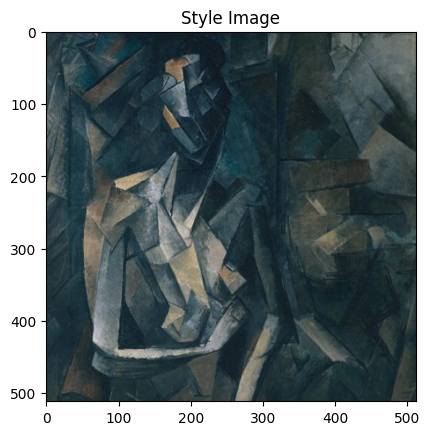

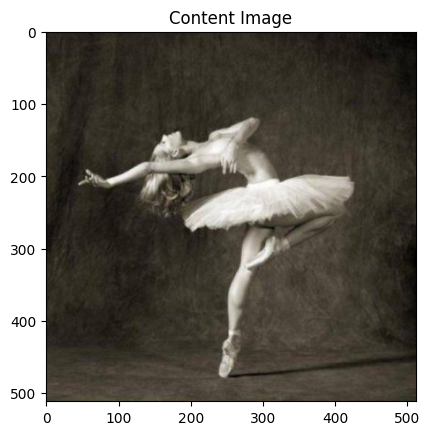

In [ ]:
style_img_path = '/content/drive/MyDrive/ex4_NN4I/picasso.jpg'
style_img = image_loader(style_img_path)

content_img_path = '/content/drive/MyDrive/ex4_NN4I/dancing.jpg'
content_img = image_loader(content_img_path)

plt.figure()
imshow(style_img, title='Style Image')

plt.figure()
imshow(content_img, title='Content Image')

In [ ]:
# desired depth layers to compute style/content losses :
content_layers_default = ['conv_4']
style_layers_default = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

def get_style_content_model_and_losses(cnn, normalization_mean, normalization_std,
                               style_img, content_img,
                               style_loss_class=StyleLoss,
                               content_layers=content_layers_default,
                               style_layers=style_layers_default):
    # normalization module
    normalization = Normalization(normalization_mean, normalization_std).to(device)

    # just in order to have an iterable access to or list of content/style
    # losses
    content_losses = []
    style_losses = []

    # assuming that ``cnn`` is a ``nn.Sequential``, so we make a new ``nn.Sequential``
    # to put in modules that are supposed to be activated sequentially
    model = nn.Sequential(normalization)

    i = 0  # increment every time we see a conv
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            # The in-place version doesn't play very nicely with the ``ContentLoss``
            # and ``StyleLoss`` we insert below. So we replace with out-of-place
            # ones here.
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        model.add_module(name, layer)

        if name in content_layers:
            # add content loss:
            target = model(content_img).detach()
            content_loss = ContentLoss(target)
            model.add_module("content_loss_{}".format(i), content_loss)
            content_losses.append(content_loss)

        if name in style_layers:
            # add style loss:
            target_feature = model(style_img).detach()
            style_loss = style_loss_class(target_feature)
            model.add_module("style_loss_{}".format(i), style_loss)
            style_losses.append(style_loss)

    # now we trim off the layers after the last content and style losses
    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], ContentLoss) or isinstance(model[i], style_loss_class):
            break

    model = model[:(i + 1)]

    return model, style_losses, content_losses

In [ ]:
def run_style_transfer(cnn, normalization_mean, normalization_std,
                       content_img, style_img, input_img, style_loss_class=StyleLoss, num_steps=300,
                       style_weight=1000000, content_weight=1):
    """Run the style transfer."""
    print('Building the style transfer model..')
    model, style_losses, content_losses = get_style_content_model_and_losses(cnn,
        normalization_mean, normalization_std, style_img, content_img, style_loss_class)

    # We want to optimize the input and not the model parameters so we
    # update all the requires_grad fields accordingly
    input_img.requires_grad_(True)
    # We also put the model in evaluation mode, so that specific layers
    # such as dropout or batch normalization layers behave correctly.
    model.eval()
    model.requires_grad_(False)

    optimizer = get_input_optimizer(input_img)

    print('Optimizing..')
    run = [0]
    while run[0] <= num_steps:

        def closure():
            # correct the values of updated input image
            with torch.no_grad():
                input_img.clamp_(0, 1)

            optimizer.zero_grad()
            model(input_img)
            style_score = 0
            content_score = 0

            for sl in style_losses:
                style_score += sl.loss
            for cl in content_losses:
                content_score += cl.loss

            style_score *= style_weight
            content_score *= content_weight

            loss = style_score + content_score
            loss.backward()

            run[0] += 1
            if run[0] % 50 == 0:
                print("run {}:".format(run))
                print('Style Loss : {:4f} Content Loss: {:4f}'.format(
                    style_score.item(), content_score.item()))
                print()

            return style_score + content_score

        optimizer.step(closure)

    # a last correction...
    with torch.no_grad():
        input_img.clamp_(0, 1)

    return input_img

In [ ]:
def calculate_mean_var(input):
    a, b, c, d = input.size()
    features = input.view(a, b, -1)

    # Calculate mean and variance along the spatial dimensions
    mean = torch.mean(features, dim=2, keepdim=True)
    var = torch.var(features, dim=2, keepdim=True)

    return mean, var

In [ ]:
class MeanVarStyleLoss(nn.Module):
    def __init__(self, target_feature):
        super(MeanVarStyleLoss, self).__init__()
        self.target_mean, self.target_var = calculate_mean_var(target_feature)

    def forward(self, input):
        input_mean, input_var = calculate_mean_var(input)
        self.loss = F.mse_loss(input_mean, self.target_mean) + F.mse_loss(input_var, self.target_var)
        return input

In [ ]:
input_img = content_img.clone()
output_gram_style_loss_img = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_img, style_img, input_img)
output_gram_style_loss_img = unloader(output_gram_style_loss_img.cpu().clone().squeeze(0))

input_img = content_img.clone()
output_meanvar_style_loss_img = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_img, style_img, input_img, MeanVarStyleLoss)
output_meanvar_style_loss_img = unloader(output_meanvar_style_loss_img.cpu().clone().squeeze(0))

Building the style transfer model..


<ipython-input-11-a40ef7ea97e5>:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.mean = torch.tensor(mean).view(-1, 1, 1)
<ipython-input-11-a40ef7ea97e5>:13: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.std = torch.tensor(std).view(-1, 1, 1)


Optimizing..
run [50]:
Style Loss : 3.912559 Content Loss: 4.139599

run [100]:
Style Loss : 1.123970 Content Loss: 3.030677

run [150]:
Style Loss : 0.719061 Content Loss: 2.660763

run [200]:
Style Loss : 0.483912 Content Loss: 2.499952

run [250]:
Style Loss : 0.351601 Content Loss: 2.411971

run [300]:
Style Loss : 0.266079 Content Loss: 2.358431

Building the style transfer model..
Optimizing..
run [50]:
Style Loss : 878598.250000 Content Loss: 4.383309

run [100]:
Style Loss : 251686.093750 Content Loss: 5.369041

run [150]:
Style Loss : 39562.746094 Content Loss: 5.968233

run [200]:
Style Loss : 21660.572266 Content Loss: 6.058479

run [250]:
Style Loss : 16263.969727 Content Loss: 6.105420

run [300]:
Style Loss : 13003.022461 Content Loss: 6.144032



In [ ]:
def compare_results(img1, img2, title1, title2):
  fig, axs = plt.subplots(1, 2, figsize=(10, 50))
  axs[0].imshow(img1)
  axs[0].axis('off')
  axs[0].set_title(title1)
  axs[1].imshow(img2)
  axs[1].axis('off')
  axs[1].set_title(title2)

  plt.ioff()
  plt.show()

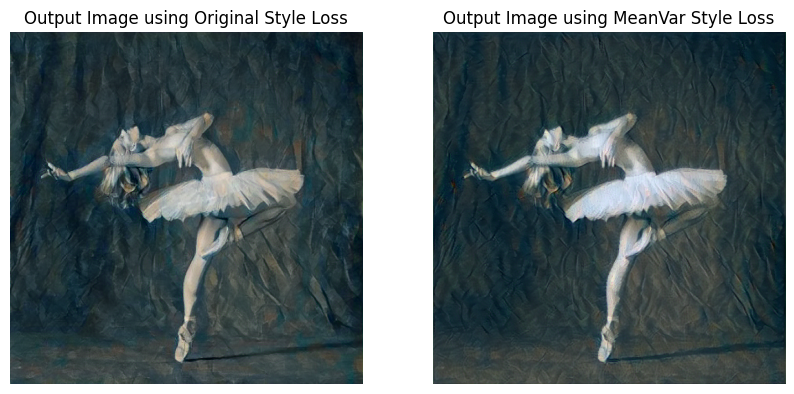

In [ ]:
compare_results(output_gram_style_loss_img, output_meanvar_style_loss_img,
                'Output Image using Original Style Loss',
                'Output Image using MeanVar Style Loss')

# Part 2 - StyleLoss-Guided Diffusion

In [ ]:
!pip3 install -U git+https://github.com/huggingface/diffusers.git

In [ ]:
!pip install transformers

## Deconstruct the Stable Diffusion pipeline

Stable Diffusion is a text-to-image latent diffusion model. It is called a latent diffusion model because it works with a lower-dimensional representation of the image instead of the actual pixel space, which makes it more memory efficient. The encoder compresses the image into a smaller representation, and a decoder to convert the compressed representation back into an image. For text-to-image models, you'll need a tokenizer and an encoder to generate text embeddings. From the previous example, you already know you need a UNet model and a scheduler.

As you can see, this is already more complex than the DDPM pipeline which only contains a UNet model. The Stable Diffusion model has three separate pretrained models.

💡 Read the How does Stable Diffusion work? blog for more details about how the VAE, UNet, and text encoder models.

Now that you know what you need for the Stable Diffusion pipeline, load all these components with the from_pretrained() method. You can find them in the pretrained runwayml/stable-diffusion-v1-5 checkpoint, and each component is stored in a separate subfolder:

In [ ]:
import torch
from transformers import CLIPTextModel, CLIPTokenizer
from diffusers import AutoencoderKL, UNet2DConditionModel, PNDMScheduler

vae = AutoencoderKL.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="vae")
tokenizer = CLIPTokenizer.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="tokenizer")
text_encoder = CLIPTextModel.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="text_encoder")
unet = UNet2DConditionModel.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="unet")

In [ ]:
from diffusers import UniPCMultistepScheduler

scheduler = UniPCMultistepScheduler.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="scheduler")

To speed up inference, move the models to a GPU since, unlike the scheduler, they have trainable weights:

In [ ]:
torch_device = "cuda"
vae.to(torch_device)
text_encoder.to(torch_device)
unet.to(torch_device)

### Create text embeddings

The next step is to tokenize the text to generate embeddings. The text is used to condition the UNet model and steer the diffusion process towards something that resembles the input prompt.

<Tip>

💡 The `guidance_scale` parameter determines how much weight should be given to the prompt when generating an image.

</Tip>

Feel free to choose any prompt you like if you want to generate something else!

In [ ]:
prompt = ["a cat with a hat"]
height = 512  # default height of Stable Diffusion
width = 512  # default width of Stable Diffusion
num_inference_steps = 100  # Number of denoising steps
guidance_scale = 7.5  # Scale for classifier-free guidance
generator = torch.manual_seed(0)  # Seed generator to create the inital latent noise
batch_size = len(prompt)

Tokenize the text and generate the embeddings from the prompt:

In [ ]:
text_input = tokenizer(
    prompt, padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt"
)
text_encoder.eval()
with torch.no_grad():
    text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]

You'll also need to generate the *unconditional text embeddings* which are the embeddings for the padding token. These need to have the same shape (`batch_size` and `seq_length`) as the conditional `text_embeddings`:

In [ ]:
max_length = text_input.input_ids.shape[-1]
uncond_input = tokenizer([""] * batch_size, padding="max_length", max_length=max_length, return_tensors="pt")
uncond_embeddings = text_encoder(uncond_input.input_ids.to(torch_device))[0]

Let's concatenate the conditional and unconditional embeddings into a batch to avoid doing two forward passes:

In [ ]:
text_embeddings = torch.cat([uncond_embeddings, text_embeddings])

### Create random noise

Next, generate some initial random noise as a starting point for the diffusion process. This is the latent representation of the image, and it'll be gradually denoised. At this point, the `latent` image is smaller than the final image size but that's okay though because the model will transform it into the final 512x512 image dimensions later.

In [ ]:
latents = torch.randn(
    (batch_size, unet.in_channels, height // 8, width // 8),
    generator=generator,
)
latents = latents.to(torch_device)

<ipython-input-105-007cfaacb096>:2: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (batch_size, unet.in_channels, height // 8, width // 8),


### Denoise the image

Start by scaling the input with the initial noise distribution, *sigma*, the noise scale value, which is required for improved schedulers like [UniPCMultistepScheduler](https://huggingface.co/docs/diffusers/main/en/api/schedulers/unipc#diffusers.UniPCMultistepScheduler):

In [ ]:
latents = latents * scheduler.init_noise_sigma

In [ ]:
latents_for_style_guided_comparison = latents.clone().detach()

The last step is to create the denoising loop that'll progressively transform the pure noise in `latents` to an image described by your prompt. Remember, the denoising loop needs to do three things:

1. Set the scheduler's timesteps to use during denoising.
2. Iterate over the timesteps.
3. At each timestep, call the UNet model to predict the noise residual and pass it to the scheduler to compute the previous noisy sample.

In [ ]:
from tqdm.auto import tqdm

scheduler.set_timesteps(num_inference_steps)

for t in tqdm(scheduler.timesteps):
    # expand the latents if we are doing classifier-free guidance to avoid doing two forward passes.
    latent_model_input = torch.cat([latents] * 2)

    latent_model_input = scheduler.scale_model_input(latent_model_input, timestep=t)

    # predict the noise residual
    with torch.no_grad():
        noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
    noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

    # compute the previous noisy sample x_t -> x_t-1
    latents = scheduler.step(noise_pred, t, latents).prev_sample

  0%|          | 0/100 [00:00<?, ?it/s]

### Decode the image without any style added to the text prompt

The final step is to use the `vae` to decode the latent representation into an image and get the decoded output with `sample`:

In [ ]:
# scale and decode the image latents with vae
latents = 1 / 0.18215 * latents
with torch.no_grad():
    content_image = vae.decode(latents).sample

Lastly, convert the image to a `PIL.Image` to see your generated image!

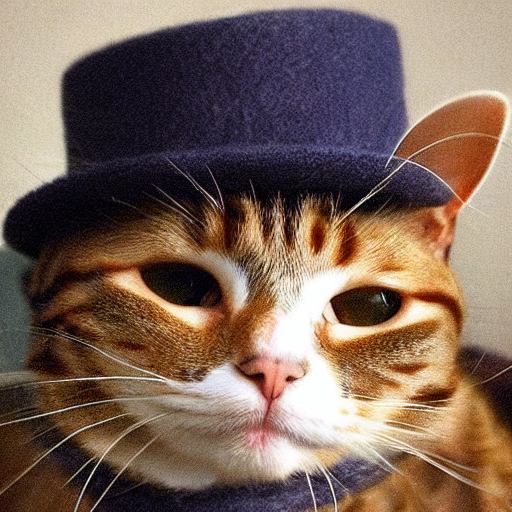

In [ ]:
content_image = (content_image / 2 + 0.5).clamp(0, 1)
content_image = content_image.detach().cpu().permute(0, 2, 3, 1).numpy()
images = (content_image * 255).round().astype("uint8")
pil_images = [Image.fromarray(image) for image in images]
pil_images[0]

### The style-guided diffusion steps

In [ ]:
latents = latents_for_style_guided_comparison.to(torch_device)

The style image for the style-guided diffusion algorithm is another version of The Starry Night by Van Gogh.

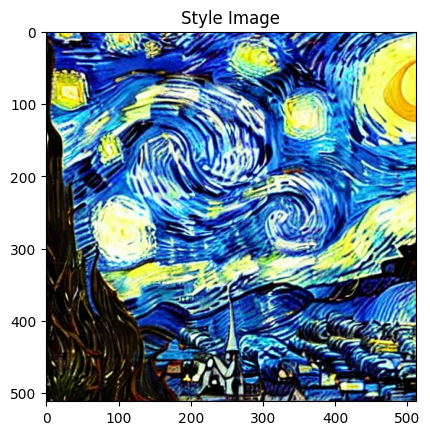

In [ ]:
style_img_path = '/content/drive/MyDrive/ex4_NN4I/van_gogh.jpg'
style_img = image_loader(style_img_path)

plt.figure()
imshow(style_img, title='Style Image')

In [ ]:
from tqdm.auto import tqdm

scheduler.set_timesteps(num_inference_steps)

style_weight = 1
model, style_losses = get_style_model_and_losses(cnn,
        cnn_normalization_mean, cnn_normalization_std, style_img)

# We also put the model in evaluation mode, so that specific layers
# such as dropout or batch normalization layers behave correctly.
vae.eval()
for param in vae.parameters():
    param.requires_grad = False
model.eval()
for param in model.parameters():
    param.requires_grad = False
unet.eval()
for param in unet.parameters():
    param.requires_grad = False

s = 0.6
for t in tqdm(scheduler.timesteps):
    # expand the latents if we are doing classifier-free guidance to avoid doing two forward passes.
    latent_model_input = torch.cat([latents] * 2)

    latent_model_input = scheduler.scale_model_input(latent_model_input, timestep=t)

    # predict the noise residual
    with torch.no_grad():
      noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
    noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

    z = torch.tensor(noise_pred.clone().detach(), requires_grad=True)
    # get the prediction of the clean image latent - x_0_hat latent
    pred_clean_image_latent = scheduler.convert_model_output(z, t, latents)

    # pass the predicted clean image to the VAE decoder and calculate the style
    # loss w.r.t to the neural net from part I
    # scale and decode the image latents with vae
    pred_clean_image_latent = 1 / 0.18215 * pred_clean_image_latent
    pred_clean_image = vae.decode(pred_clean_image_latent).sample / 2 + 0.5 # x_0_hat

    # backpropogate
    with torch.no_grad():
      pred_clean_image.clamp_(0, 1)

    model(pred_clean_image)

    style_score = 0
    for sl in style_losses:
      style_score += sl.loss
    style_score *= style_weight

    loss = style_score
    loss.backward()

    # calculate grad
    grad = z.grad / torch.mean(torch.abs(z.grad))
    # calculate variance
    variance = scheduler.sigma_t[t]

    # shift the noise
    noise_pred = noise_pred - s*variance*grad

    # compute the previous noisy sample x_t -> x_t-1
    latents = scheduler.step(noise_pred, t, latents).prev_sample

<ipython-input-13-a40ef7ea97e5>:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.mean = torch.tensor(mean).view(-1, 1, 1)
<ipython-input-13-a40ef7ea97e5>:13: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.std = torch.tensor(std).view(-1, 1, 1)


  0%|          | 0/100 [00:00<?, ?it/s]

<ipython-input-112-7ddd7ffc667c>:42: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  z = torch.tensor(noise_pred.clone().detach(), requires_grad=True)


### Decode the image + style of the style guidance algorithm

The final step is to use the `vae` to decode the latent representation into an image and get the decoded output with `sample`:

In [ ]:
# scale and decode the image latents with vae
latents = 1 / 0.18215 * latents
with torch.no_grad():
    style_guided_image = vae.decode(latents).sample

Lastly, convert the image to a `PIL.Image` to see your generated image!

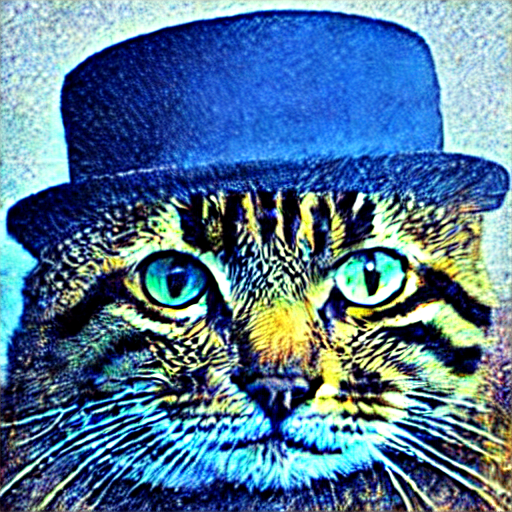

In [ ]:
style_guided_image = (style_guided_image / 2 + 0.5).clamp(0, 1)
style_guided_image = style_guided_image.detach().cpu().permute(0, 2, 3, 1).numpy()
images = (style_guided_image * 255).round().astype("uint8")
pil_images = [Image.fromarray(image) for image in images]
pil_images[0]

## A - Comparing between the results of the style-guided diffusion model and the style-transfer algorithm

### Style loss for the style transfer algorithm: Gram Matrix style loss (StyleLoss)

Building the style transfer model..
Optimizing..


<ipython-input-13-a40ef7ea97e5>:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.mean = torch.tensor(mean).view(-1, 1, 1)
<ipython-input-13-a40ef7ea97e5>:13: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.std = torch.tensor(std).view(-1, 1, 1)


run [50]:
Style Loss : 122.955933 Content Loss: 55.780113

run [100]:
Style Loss : 22.200562 Content Loss: 52.833668

run [150]:
Style Loss : 11.227273 Content Loss: 49.268627

run [200]:
Style Loss : 12.216592 Content Loss: 45.636147

run [250]:
Style Loss : 136.960358 Content Loss: 42.069626

run [300]:
Style Loss : 7.772247 Content Loss: 42.334606



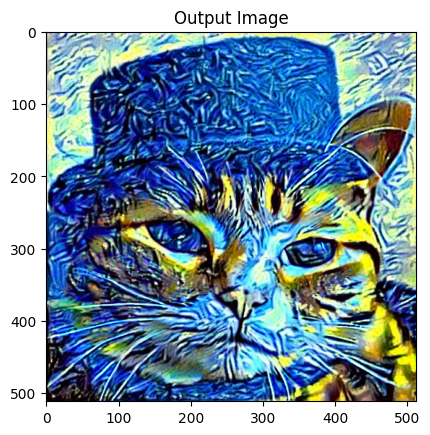

In [ ]:
content_img_path = '/content/drive/MyDrive/ex4_NN4I/cat_with_a_hat.png'
content_img = image_loader(content_img_path)

input_img = content_img.clone()

output = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_img, style_img, input_img, StyleLoss, 300, 300000)

plt.figure()
imshow(output, title='Output Image')

# sphinx_gallery_thumbnail_number = 4
plt.ioff()
plt.show()

### Style loss for the style transfer algorithm: Mean and Variance loss (MeanVarStyleLoss)

Building the style transfer model..
Optimizing..


<ipython-input-13-a40ef7ea97e5>:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.mean = torch.tensor(mean).view(-1, 1, 1)
<ipython-input-13-a40ef7ea97e5>:13: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.std = torch.tensor(std).view(-1, 1, 1)


run [50]:
Style Loss : 12694007.000000 Content Loss: 41.768097

run [100]:
Style Loss : 2594033.500000 Content Loss: 43.219772

run [150]:
Style Loss : 1030729.125000 Content Loss: 44.838360

run [200]:
Style Loss : 598427.062500 Content Loss: 45.900654

run [250]:
Style Loss : 390330.656250 Content Loss: 46.834225

run [300]:
Style Loss : 290343.375000 Content Loss: 47.712761



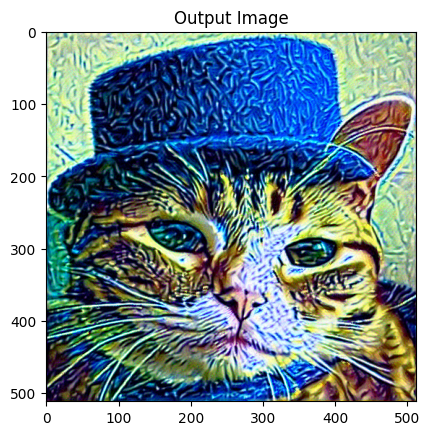

In [ ]:
content_img_path = '/content/drive/MyDrive/ex4_NN4I/cat_with_a_hat.png'
content_img = image_loader(content_img_path)

input_img = content_img.clone()

output = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_img, style_img, input_img, MeanVarStyleLoss, 300, 300000)

plt.figure()
imshow(output, title='Output Image')

# sphinx_gallery_thumbnail_number = 4
plt.ioff()
plt.show()

## B - Comparing between the results of the style loss guided output to the ordinary text-to-image stable diffusion output

In [ ]:
prompt = ["a cat with a hat in the style of The Starry Night by Van Gogh"]
height = 512  # default height of Stable Diffusion
width = 512  # default width of Stable Diffusion
num_inference_steps = 100  # Number of denoising steps
guidance_scale = 7.5  # Scale for classifier-free guidance
generator = torch.manual_seed(0)  # Seed generator to create the inital latent noise
batch_size = len(prompt)

In [ ]:
text_input = tokenizer(
    prompt, padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt"
)
text_encoder.eval()
with torch.no_grad():
    text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]

In [ ]:
max_length = text_input.input_ids.shape[-1]
uncond_input = tokenizer([""] * batch_size, padding="max_length", max_length=max_length, return_tensors="pt")
uncond_embeddings = text_encoder(uncond_input.input_ids.to(torch_device))[0]

In [ ]:
text_embeddings = torch.cat([uncond_embeddings, text_embeddings])

In [ ]:
latents = torch.randn(
    (batch_size, unet.in_channels, height // 8, width // 8),
    generator=generator,
)
latents = latents.to(torch_device)

<ipython-input-157-007cfaacb096>:2: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (batch_size, unet.in_channels, height // 8, width // 8),


In [ ]:
latents = latents * scheduler.init_noise_sigma

In [ ]:
from tqdm.auto import tqdm

scheduler.set_timesteps(num_inference_steps)

for t in tqdm(scheduler.timesteps):
    # expand the latents if we are doing classifier-free guidance to avoid doing two forward passes.
    latent_model_input = torch.cat([latents] * 2)

    latent_model_input = scheduler.scale_model_input(latent_model_input, timestep=t)

    # predict the noise residual
    with torch.no_grad():
        noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
    noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

    # compute the previous noisy sample x_t -> x_t-1
    latents = scheduler.step(noise_pred, t, latents).prev_sample

  0%|          | 0/100 [00:00<?, ?it/s]

In [ ]:
# scale and decode the image latents with vae
latents = 1 / 0.18215 * latents
with torch.no_grad():
    image = vae.decode(latents).sample

Lastly, convert the image to a `PIL.Image` to see your generated image!

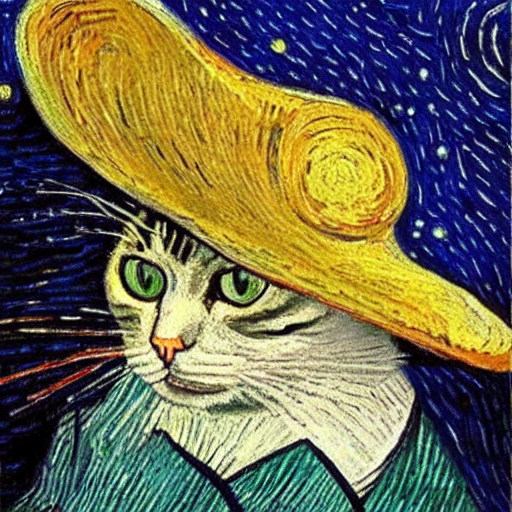

In [ ]:
image = (image / 2 + 0.5).clamp(0, 1)
image = image.detach().cpu().permute(0, 2, 3, 1).numpy()
images = (image * 255).round().astype("uint8")
pil_images = [Image.fromarray(image) for image in images]
pil_images[0]